# The self-similarity matrix for musical structure analysis 
### George Tzanetakis, University of Victoria

In this notebook we look at the self-similarity matrix (SSM) a fundamental representation that is used for automatic segmentation and musical structure analysis. Segmentation is the process of breaking up an audio recording into different segments that are perceived by human listeners as separate. This could be the verse or the chorus of a pop recording or movements of a symphony. Musical structure analysis goes a step further and also identifies relationships between these segments. For example in the well known AABA structure, the segment A is repeated twice (potentially with some amount of variation), followed by a different segment (B) and then A is heard again. The task of segmentation refers to identifying the boundaries in time of each segment in the structure and the task of structure analysis refers to the process of grouping together segments of the same type. Musical structure typically occurs hierarchically so each segment can be further organized in smaller segments for example based on melodic patterns. 

There is a wide variety of approach to musical structure analysis but they tend to exploit the following characteristics: 

1. Novelty: the boundaries between segment tend to be locations in which the underlying audio content changes rapidly 
2. Homogeneity: the audio content of a segment tends to be relatively homogeneous  
3. Repetition: segments repeat showing recurrding patterns in the underlying representation 


Depanding on the specifics of the music analyzed, different feature represnetations can be utilized. 
For example to analyze the structure of a piece of piano music, a chroma-based representation would be more appropriate as there is not much variation in the spectral characteristics of the music. For a piece 
of rock music with a slow orchestral music introduction, using a MFCC representation might be more appropriate. 

In this notebook we will explore the beautiful jazz ballad Naima by John Coltrane that has a clear musical structure based on melodic patterns. 


In [8]:
%matplotlib inline

import matplotlib.pyplot as plt
import scipy.io.wavfile as wav
import numpy as np
import IPython.display as ipd
import librosa



def load_wav(fname): 
    srate, audio = wav.read(fname)
    audio = audio.astype(np.float32) / 32767.0 
    audio = (0.9 / np.max(audio)) * audio
    # convert to mono 
    if (len(audio.shape) == 2):
        audio = (audio[:, 0] + audio[:, 1]) / 2
    return (audio,srate) 


audio,srate = load_wav('naima.wav')

# select 1 min and 20 seconds 
audio = audio[0*int(srate):80*int(srate)]

In [5]:
ipd.Audio(audio,rate=srate)

In [6]:
# compute MFCC and Chroma representations
mfcc = librosa.feature.mfcc(y=audio, sr=srate)
chroma = librosa.feature.chroma_stft(y=audio,sr=srate,norm=2)
print(mfcc.shape)
print(chroma.shape)

(20, 6891)
(12, 6891)


The self-similarity matrix is a matrix in which each entry compares a location in time of the recording with another location in time of the same recording based on some feature vector representation. High values indicate high similarity with the diagonal being the highest possible as each time location is mapped to the same time location. One can think of the self-similarity matrix as similar to the cost-matrices we explored in Dynamic Time Warping but with the second recording being a copy of the first rather than two different recordings. Depending on the application contextm similar data structures can be calculated with names such as recurrence plot, cost-matrix, self-distance matrix. Although the details are different, at a high-level they all have similar properties and can be used for structure analysis. 



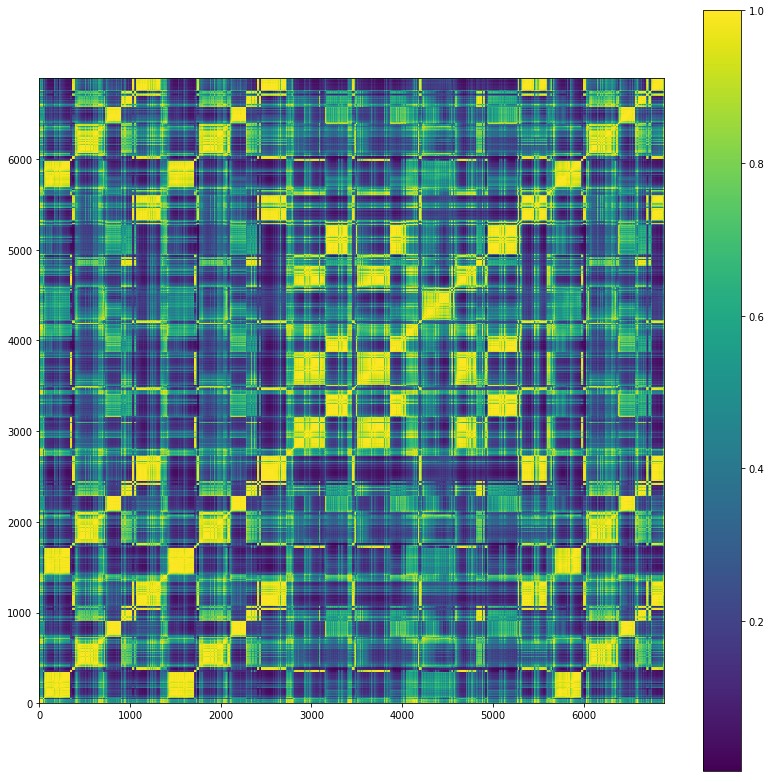

In [9]:
ssm1 = np.dot(np.transpose(chroma),chroma)
plt.figure(figsize=(14,14))
cmap = 'viridis'
plt.imshow(ssm1, cmap=cmap, origin='lower')
plt.colorbar()
plt.show()

When visually inspecting the SSM, we notice that there are multiple structures which are referred to as blocks and paths. When the feature sequence stays relatively constant over the course of a segment this results in a block of high similarity values appearing in the matrix (the yellow squares above). When there are repeating subsequences the same pattern of squares appears running parralel to the main diagonal (the offset from the diagonal corresponds to the time lag between the repeated patterns). So homegeneity shows up as block structures and repetition shows up as path-like structures. Musical structure analysis techniques work by automatically processing the SSM and identifying these visual structures. 

In the SSM above one can see a structure consisting of 5 yellow squares from 0 to about 1400 frames that then repeates as an off-diagonal path. Let's listen to the corresponding audio segment. As you can hear this corresponds to the main melodicic of Naima. 

In [10]:
segment = audio[1400*2048:2800*2048]

In [11]:
ipd.Audio(segment, rate=srate)

Let's now look at the SSM of the same recording bbut in this case using MFCC features. As you can see it captures the repetition at the bar level but it does not reveal the melodic structure that the chroma features did. 

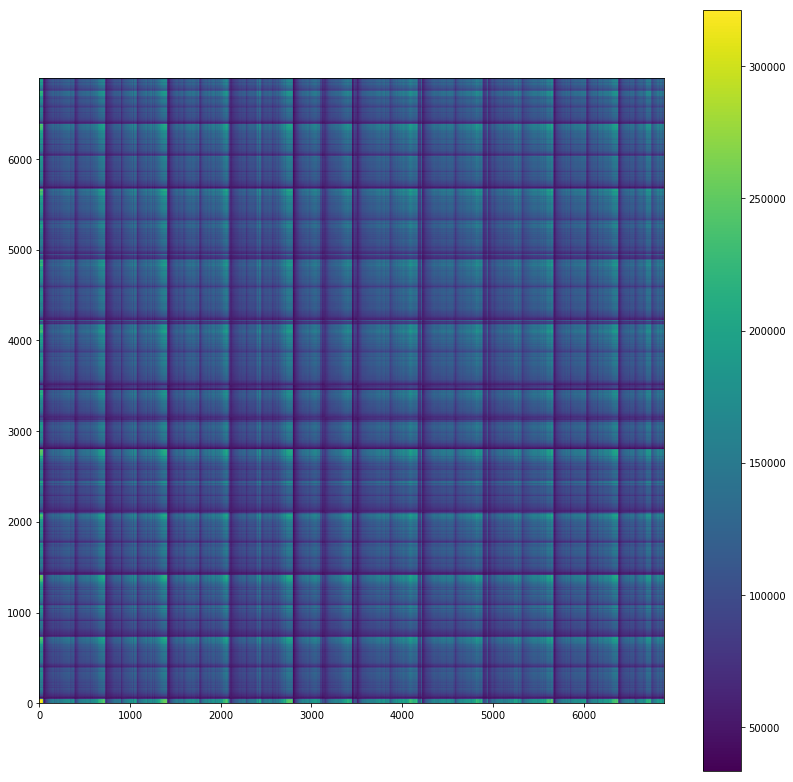

In [12]:


ssm1 = np.dot(np.transpose(mfcc),mfcc)
plt.figure(figsize=(14,14))
cmap = 'viridis'
plt.imshow(ssm1, cmap=cmap, origin='lower')
plt.colorbar()
plt.show()


In [14]:
audio,srate = load_wav('elo_beethoven.wav')
ipd.Audio(audio, rate=srate)

In [16]:
mfcc = librosa.feature.mfcc(y=audio, sr=srate)
chroma = librosa.feature.chroma_stft(y=audio,sr=srate,norm=2)

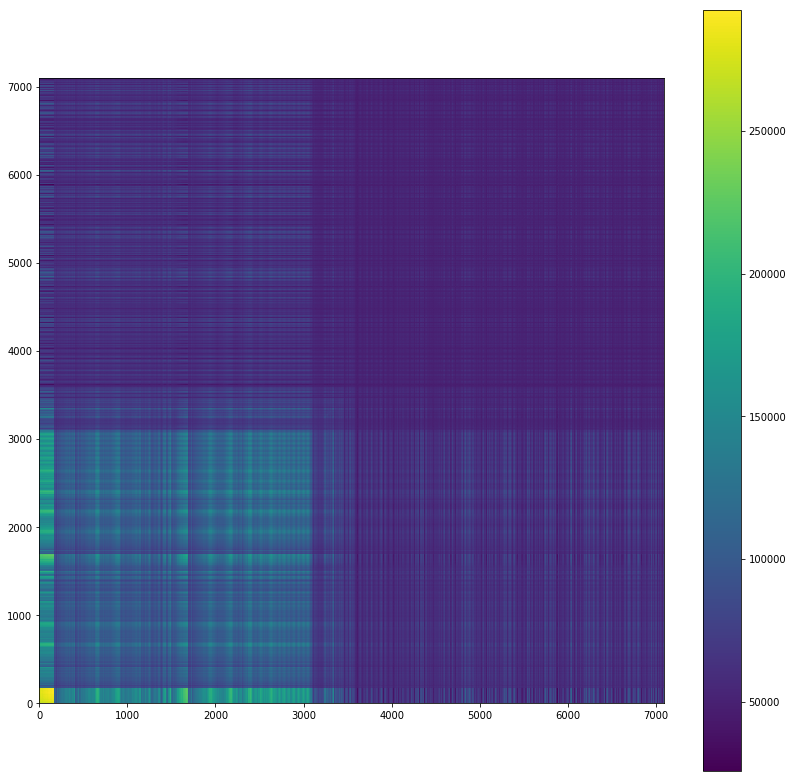

In [17]:
ssm1 = np.dot(np.transpose(mfcc),mfcc)
plt.figure(figsize=(14,14))
cmap = 'viridis'
plt.imshow(ssm1, cmap=cmap, origin='lower')
plt.colorbar()
plt.show()

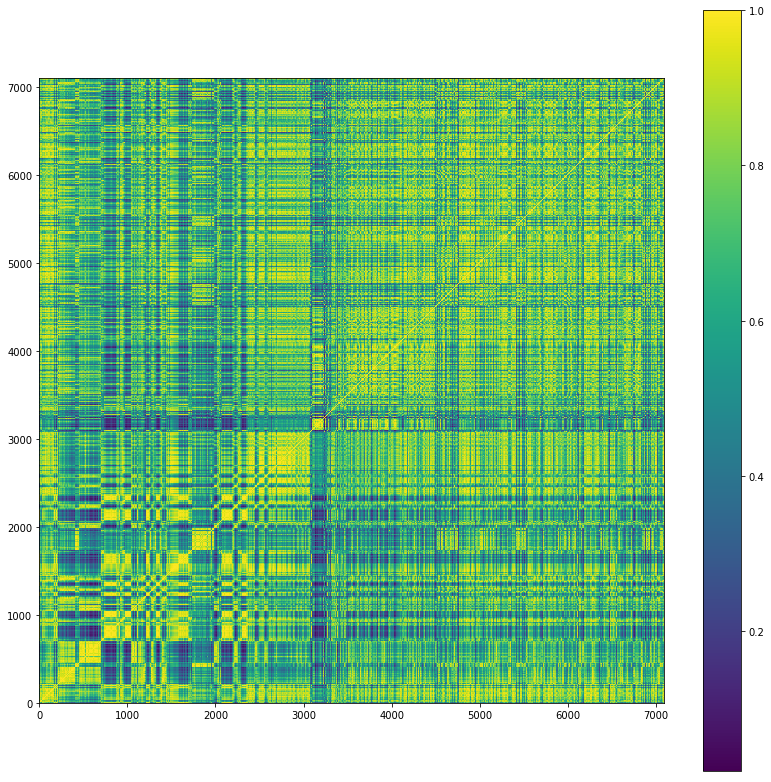

In [19]:
ssm1 = np.dot(np.transpose(chroma),chroma)
plt.figure(figsize=(14,14))
cmap = 'viridis'
plt.imshow(ssm1, cmap=cmap, origin='lower')
plt.colorbar()
plt.show()

To summarize, the self-similarity matrix can be computed by considering the similarity of every feature vector 
in a time-sequence repreresenting a music track to every feature vector at potentially different times for the same music track. Musical structure analysis algorithms identify block and path structure in the SSM that reflect feature homogeneity and repetitiveness. Different feature representations reveal different aspects of the musical structure. 

